In [1]:
import os  # helps you to interact with operating system, 
# managing files and directories 
# finding current directories, 
# working with enviornment variables 
import pandas as pd  # for dataframe 
import numpy as np  # handaling arrays
import cv2  # used for image processing and computer vision
# read and write files, Object detections(faces) and more 
import matplotlib.pyplot as plt 
from tqdm import tqdm # shows the level of progress
import random 
import concurrent.futures # for parallel execution of tasks 
import seaborn as sns
import pickle
import shutil
from sklearn.model_selection import train_test_split

(-0.5, 1023.5, 730.5, -0.5)

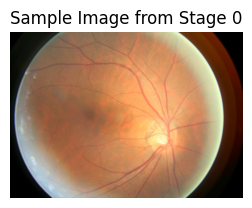

In [2]:
# visualizing an image from a train set 
train_path = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/train"
sample_imgpath = os.path.join(train_path,"0",os.listdir(os.path.join(train_path,"0"))[0])

# read image using OpenCV
img = cv2.imread(sample_imgpath) # cv2 loads image in BGR format only by default 
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(3,3))
plt.imshow(img)
plt.title("Sample Image from Stage 0")
plt.axis("off")

In [3]:
# root directory where train, test, and val folders are located
root_dir = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2"  

# Function to create a dataframe from a given directory
def create_dataframe(split):
    data = []
    split_path = os.path.join(root_dir, split)  # train, test, or val

    for label in os.listdir(split_path):  # 0, 1, 2, 3, 4
        label_path = os.path.join(split_path, label)
        
        if os.path.isdir(label_path):  # Ensure it's a directory
            for img_file in os.listdir(label_path):
                img_path = os.path.join(label_path, img_file)
                data.append((img_path, int(label)))  # Store path and label as int

    return pd.DataFrame(data, columns=["image_path", "label"])

# Create DataFrames for train, val, and test
train_df = create_dataframe("train")
val_df = create_dataframe("val")
test_df = create_dataframe("test")


print("Shape of train_df",train_df.shape)
print("Shape of test_df",test_df.shape)
print("Shape of val_df",val_df.shape)

Shape of train_df (73949, 2)
Shape of test_df (9261, 2)
Shape of val_df (9245, 2)


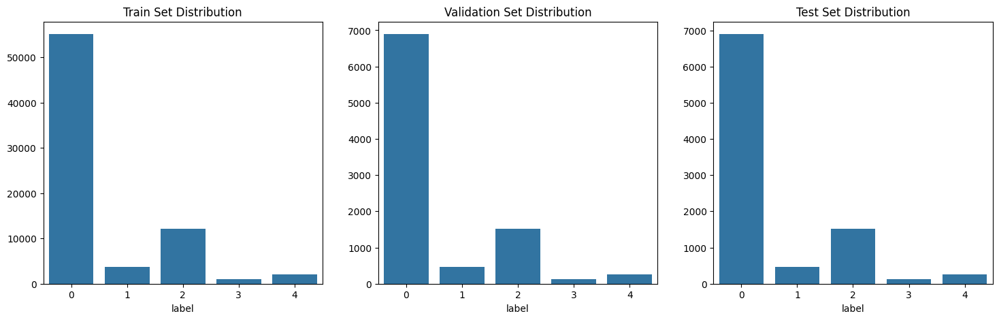

In [4]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

sns.barplot(x=train_df['label'].value_counts().index, y=train_df['label'].value_counts().values, ax=axes[0])
axes[0].set_title("Train Set Distribution")

sns.barplot(x=val_df['label'].value_counts().index, y=val_df['label'].value_counts().values, ax=axes[1])
axes[1].set_title("Validation Set Distribution")

sns.barplot(x=test_df['label'].value_counts().index, y=test_df['label'].value_counts().values, ax=axes[2])
axes[2].set_title("Test Set Distribution")

plt.show()

# Clubbing all the images to all_df to preprocess them alltogather and then will split before passing them to the model 

In [5]:
all_df = pd.concat([train_df, test_df, val_df], ignore_index=True)
print("Shape of all_df:", all_df.shape)

Shape of all_df: (92455, 2)


In [6]:
all_df.head()

,image_path,label
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0


<Axes: xlabel='label'>

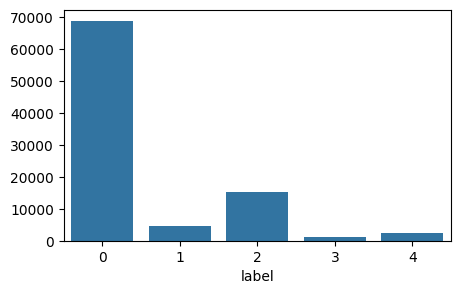

In [7]:
plt.figure(figsize=(5,3))

sns.barplot(x=all_df['label'].value_counts().index, y=all_df['label'].value_counts().values)

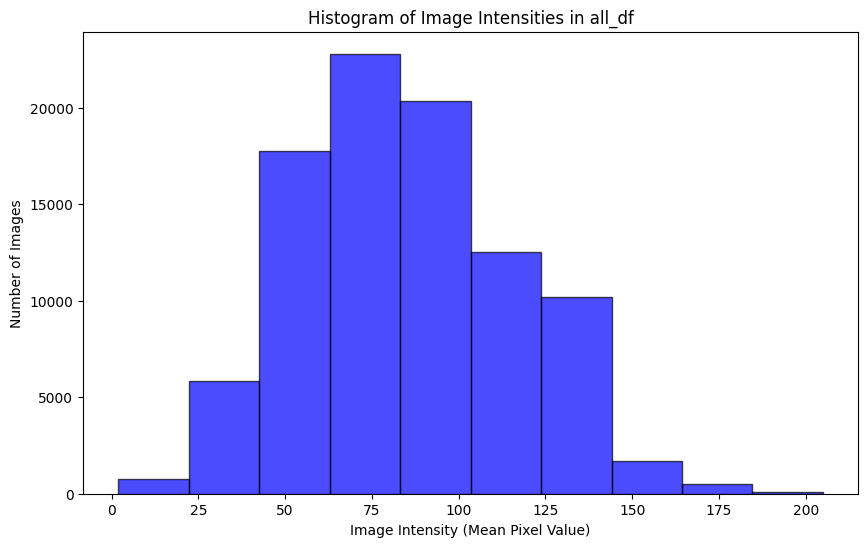

In [8]:
# Function to calculate the average intensity of an image
def calculate_intensity(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load in grayscale
    return np.mean(img)  # Calculate mean intensity

# Apply the function to all images in all_df
all_df['intensity'] = all_df['image_path'].apply(calculate_intensity)

# Create histogram
plt.figure(figsize=(10, 6))
plt.hist(all_df['intensity'], bins=10, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel("Image Intensity (Mean Pixel Value)")
plt.ylabel("Number of Images")
plt.title("Histogram of Image Intensities in all_df")
plt.show()

# Visualizing 5 images from each bin

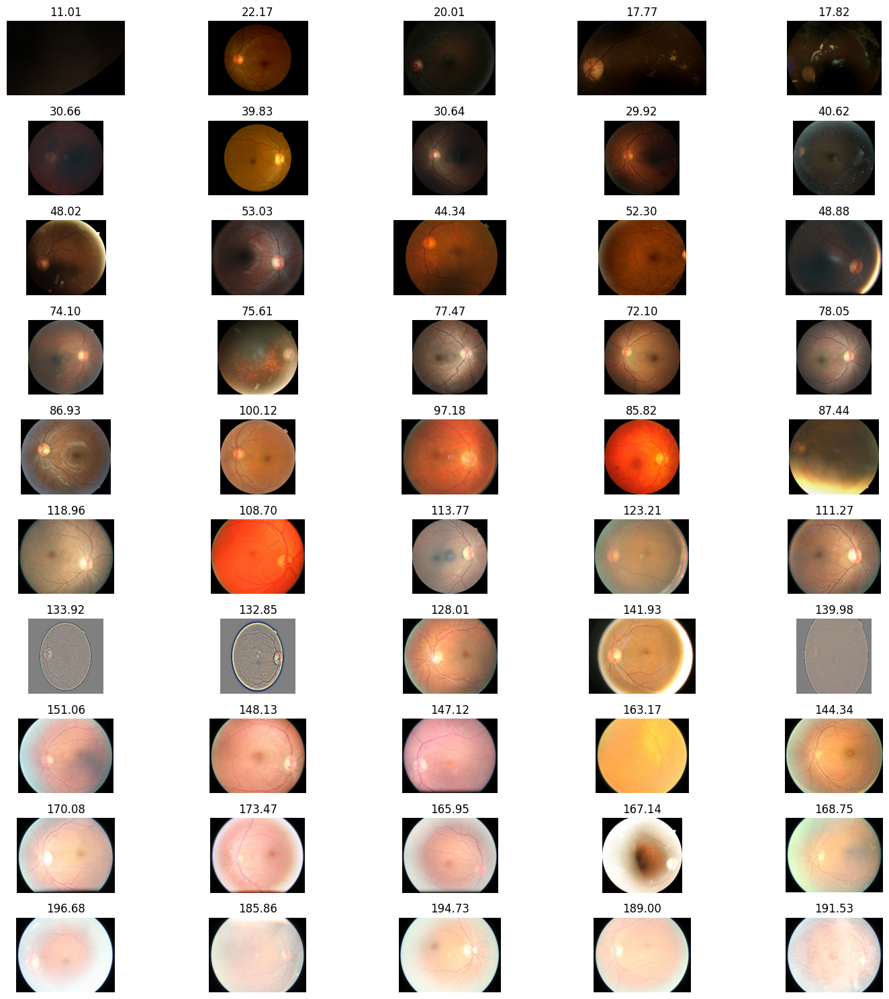

In [9]:
num_bins = 10

# Bin images based on intensity
all_df['bin'] = pd.cut(all_df['intensity'], bins=num_bins, labels=False)

# Function to display 5 random images from each bin with intensity values
def show_images_from_bins(df, num_samples=5):
    unique_bins = df['bin'].dropna().unique()  # Remove NaN bins (if any)
    fig, axes = plt.subplots(len(unique_bins), num_samples, figsize=(15, 15))

    for i, bin_value in enumerate(sorted(unique_bins)):
        bin_images = df[df['bin'] == bin_value].sample(n=min(num_samples, len(df[df['bin'] == bin_value])), random_state=42)

        for j, (_, row) in enumerate(bin_images.iterrows()):
            img = cv2.imread(row['image_path'])
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
            
            # Display image
            axes[i, j].imshow(img)
            axes[i, j].axis("off")

            # Set title with bin number and intensity value
            intensity = row['intensity']
            axes[i, j].set_title(f"{intensity:.2f}")

    plt.tight_layout()
    plt.show()

# Show images from each bin
show_images_from_bins(all_df)

we can see that images vary in terms of contrast and clearity. Thus our focus will be on enhancing image quality.

# Cropping Images # Removing dark part around the retina using masking and visualising them

In [10]:
cropped_dir = os.path.join(root_dir, "cropped_all")
os.makedirs(cropped_dir, exist_ok=True)

# Function to apply circular mask and crop image
def crop_black_parts(row):
    img_path = row['image_path']
    img = cv2.imread(img_path)
    
    if img is not None:
        h, w = img.shape[:2]
        mask = np.zeros((h, w), dtype=np.uint8)
        center = (w // 2, h // 2)
        radius = min(center[0], center[1])
        cv2.circle(mask, center, radius, 255, -1)
        
        img_cropped = cv2.bitwise_and(img, img, mask=mask)
        new_path = os.path.join(cropped_dir, os.path.basename(img_path))
        cv2.imwrite(new_path, img_cropped)
        return new_path  # Return new image path
    
    return None  # If image loading fails

def crop_and_save_images(df):
    with concurrent.futures.ThreadPoolExecutor() as executor:
        results = list(tqdm(
            executor.map(crop_black_parts, df.to_dict(orient='records')),
            total=len(df),
            desc="Cropping images"
        ))
    
    df['cropped_img_path'] = results
    return df

all_df = crop_and_save_images(all_df)
all_df.to_csv("cropped_resized_all.csv", index=False)

Cropping images: 100%|██████████| 92455/92455 [03:34<00:00, 430.86it/s]


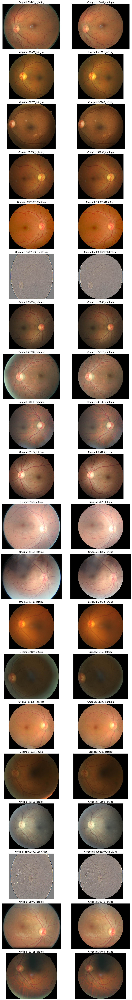

In [11]:
def visualize_original_and_cropped(df, num_samples=20):
    # Select random samples
    samples = df.sample(num_samples)
    
    # Set up the plot
    fig, axes = plt.subplots(num_samples, 2, figsize=(12, 4*num_samples))
    
    # Loop through samples
    for i, (_, row) in enumerate(samples.iterrows()):
        # Load original image
        original_img = cv2.imread(row['image_path'])
        original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        
        # Load cropped image
        cropped_img = cv2.imread(row['cropped_img_path'])
        cropped_img = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
        
        # Display original image
        axes[i][0].imshow(original_img)
        axes[i][0].set_title(f"Original: {os.path.basename(row['image_path'])}")
        axes[i][0].axis('off')
        
        # Display cropped image
        axes[i][1].imshow(cropped_img)
        axes[i][1].set_title(f"Cropped: {os.path.basename(row['cropped_img_path'])}")
        axes[i][1].axis('off')
    
    plt.tight_layout()
    plt.show()

# Call the function to visualize
visualize_original_and_cropped(all_df, num_samples=20)

In [12]:
all_df.head()

,image_path,label,intensity,bin,cropped_img_path
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...


# Resizing the images and visualizing them # Since pretrained models requires specific size of images, resizing is the foremost step

In [13]:
resized_dir = os.path.join(root_dir, "cropped_resized_all")
os.makedirs(resized_dir, exist_ok=True)

# Function to resize the cropped image
def resize_cropped_image(row, target_size=(456, 456)):
    img_path = row['cropped_img_path']
    img = cv2.imread(img_path)
    
    if img is not None:
        img = cv2.resize(img, target_size)
        new_path = os.path.join(resized_dir, os.path.basename(img_path))
        cv2.imwrite(new_path, img)
        return new_path  # Return new image path
    
    return None  # If image loading fails

# Parallel processing for resizing cropped images
def resize_images(df, target_size=(456, 456)):
    with concurrent.futures.ThreadPoolExecutor() as executor:
        results = list(tqdm(
            executor.map(lambda row: resize_cropped_image(row, target_size), df.to_dict(orient='records')),
            total=len(df),
            desc="Resizing cropped images"
        ))
    
    df['resized_cropped_img_path'] = results
    return df

# Apply resizing to cropped images and update DataFrame
all_df = resize_images(all_df)

# Save the updated DataFrame as CSV
all_df.to_csv("cropped_resized_all.csv", index=False)

Resizing cropped images: 100%|██████████| 92455/92455 [02:02<00:00, 757.24it/s]


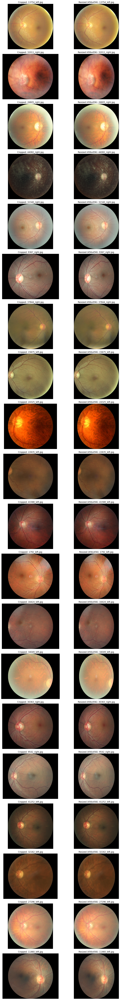

In [14]:
def visualize_cropped_and_resized(df, num_samples=20):
    # Select random samples
    samples = df.sample(num_samples)
    
    # Set up the plot
    fig, axes = plt.subplots(num_samples, 2, figsize=(12, 4*num_samples))
    
    # Loop through samples
    for i, (_, row) in enumerate(samples.iterrows()):
        # Load cropped image
        cropped_img = cv2.imread(row['cropped_img_path'])
        cropped_img = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
        
        # Load resized cropped image
        resized_cropped_img = cv2.imread(row['resized_cropped_img_path'])
        resized_cropped_img = cv2.cvtColor(resized_cropped_img, cv2.COLOR_BGR2RGB)
        
        # Display cropped image
        axes[i][0].imshow(cropped_img)
        axes[i][0].set_title(f"Cropped: {os.path.basename(row['cropped_img_path'])}")
        axes[i][0].axis('off')
        
        # Display resized cropped image
        axes[i][1].imshow(resized_cropped_img)
        axes[i][1].set_title(f"Resized (456x456): {os.path.basename(row['resized_cropped_img_path'])}")
        axes[i][1].axis('off')
    
    plt.tight_layout()
    plt.show()

# Call the function to visualize
visualize_cropped_and_resized(all_df, num_samples=20)

In [20]:
all_df = pd.read_csv("cropped_resized_all.csv")
all_df.head()

,image_path,label,intensity,bin,cropped_img_path,resized_cropped_img_path
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...


# Applying clahe of clip limit 4.0 to images less then intensity 40 and 2.0 to images greater then intensity 40

ps : clahe of clip limit 2.0 was applied to all the images previously. It was reveled that images with intensity less then 40 requires more enahncement

In [21]:
# Define CLAHE function for RGB images using LAB space
def apply_clahe_lab(img_path, clip_limit, tile_grid_size=(8, 8)):
    img = cv2.imread(img_path)  # Read image (BGR format)
    if img is None:
        return None  # Skip if image is not found

    # Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)

    # Apply CLAHE only on the L (Luminance) channel
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l_clahe = clahe.apply(l)

    # Merge channels back and convert to RGB
    lab_clahe = cv2.merge([l_clahe, a, b])
    clahe_rgb = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2RGB)

    return clahe_rgb

# Directory to save CLAHE-processed RGB images
clahe_rgb_dir = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/clahe_rgb_img"
os.makedirs(clahe_rgb_dir, exist_ok=True)

# Initialize lists to store new paths
clahe_paths = []

# Apply CLAHE to all images
for idx, row in tqdm(all_df.iterrows(), total=len(all_df), desc="Applying CLAHE"):
    img_path = row["resized_cropped_img_path"]  # Path to original image
    original_intensity = row["intensity"]

    # Determine CLAHE clip limit based on intensity
    clip_limit = 4.0 if original_intensity < 40 else 2.0

    # Apply CLAHE enhancement
    clahe_img = apply_clahe_lab(img_path, clip_limit)

    if clahe_img is not None:
        # Save the enhanced image
        new_path = os.path.join(clahe_rgb_dir, os.path.basename(img_path))
        cv2.imwrite(new_path, cv2.cvtColor(clahe_img, cv2.COLOR_RGB2BGR))  # Save in correct format
        clahe_paths.append(new_path)
    else:
        clahe_paths.append(None)

# Update DataFrame
all_df["clahe_rgb_img_path"] = clahe_paths

# Save updated DataFrame
all_df.to_csv("clahe_rgb_all.csv", index=False)

Applying CLAHE: 100%|██████████| 92455/92455 [04:53<00:00, 314.88it/s] 


In [22]:
def compute_intensity(img_path):
    img = cv2.imread(img_path)  # Read image
    if img is None:
        return None  # Handle missing images
    
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
    return np.mean(img_gray)  # Compute mean intensity

# Compute intensity for CLAHE-processed RGB images
new_intensities = []
for img_path in tqdm(all_df["clahe_rgb_img_path"], desc="Computing Intensity"):
    new_intensities.append(compute_intensity(img_path))

# Add to DataFrame
all_df["new_image_intensity"] = new_intensities

Computing Intensity: 100%|██████████| 92455/92455 [01:36<00:00, 957.15it/s] 


In [23]:
all_df.head()

,image_path,label,intensity,bin,cropped_img_path,resized_cropped_img_path,clahe_rgb_img_path,new_image_intensity
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,79.770064
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,66.015134
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.230956
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.100324
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,69.631237


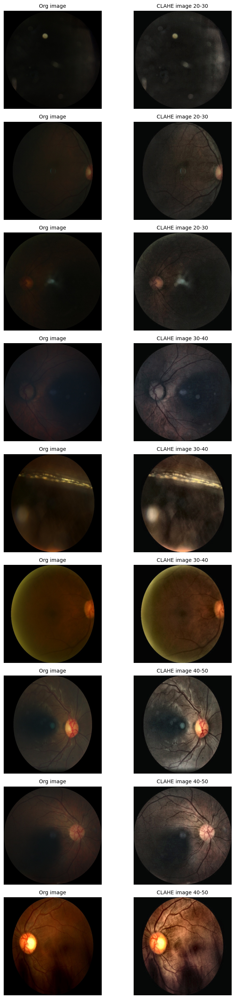

In [25]:
# Function to visualize CLAHE effect [original vs. CLAHE RGB images] 
def visualize_clahe_effect_rgb(df, bins, num_samples=3):
    fig, axes = plt.subplots(len(bins) * num_samples, 2, figsize=(8, len(bins) * num_samples * 3))

    row_idx = 0
    for low, high in bins:
        # Filter images based on computed intensity
        bin_images = df[(df["new_image_intensity"] >= low) & (df["new_image_intensity"] < high)]

        if len(bin_images) == 0:
            continue  # Skip empty bins

        sampled_images = bin_images.sample(n=min(num_samples, len(bin_images)), random_state=42)

        for _, row in sampled_images.iterrows():
            # Load original image
            orig_img = cv2.imread(row["resized_cropped_img_path"])
            orig_img = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)

            # Load CLAHE RGB image
            clahe_img = cv2.imread(row["clahe_rgb_img_path"])
            clahe_img = cv2.cvtColor(clahe_img, cv2.COLOR_BGR2RGB)

            # Left column: Original image
            axes[row_idx, 0].imshow(orig_img)
            axes[row_idx, 0].axis("off")
            axes[row_idx, 0].set_title(f"Org image", fontsize=10)

            # Right column: CLAHE-processed image
            axes[row_idx, 1].imshow(clahe_img)
            axes[row_idx, 1].axis("off")
            axes[row_idx, 1].set_title(f"CLAHE image {low}-{high}", fontsize=10)

            row_idx += 1  # Move to next row

    plt.tight_layout()
    plt.show()

# Define intensity bins [(low, high)]
intensity_bins = [(20, 30), (30, 40), (40, 50)]

# Call function to visualize
visualize_clahe_effect_rgb(all_df, intensity_bins)


# Normalizing the images

In [26]:
# Create a directory to save normalized images
norm_dir = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/norm_img"
os.makedirs(norm_dir, exist_ok=True)

# Function to normalize and save images
def normalize_and_save(img_path, save_dir):
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)  # Read image
    if img is None:
        return None  # Return None if image is missing
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    img = img.astype(np.float32) / 255.0  # Normalize pixel values to [0,1]
    
    # Convert to uint8 (0-255) and save
    norm_img = (img * 255).astype(np.uint8)
    save_path = os.path.join(save_dir, os.path.basename(img_path))  # Keep same filename
    cv2.imwrite(save_path, cv2.cvtColor(norm_img, cv2.COLOR_RGB2BGR))  # Save as BGR
    
    return save_path  # Return new file path

In [27]:
# Apply normalization in batches
batch_size = 5000
num_batches = len(all_df) // batch_size + 1
normalized_paths = []

print("Normalizing and saving images in batches...")
for i in tqdm(range(num_batches), desc="Processing batches"):
    batch_paths = all_df["clahe_rgb_img_path"].iloc[i * batch_size : (i + 1) * batch_size]  # Get batch
    batch_norm_paths = [normalize_and_save(img_path, norm_dir) for img_path in batch_paths]  # Process batch
    normalized_paths.extend(batch_norm_paths)  # Store results

# Store new paths in DataFrame
all_df["norm_img_path"] = normalized_paths

Normalizing and saving images in batches...


Processing batches: 100%|██████████| 19/19 [03:42<00:00, 11.73s/it]


In [28]:
all_df.head()

,image_path,label,intensity,bin,cropped_img_path,resized_cropped_img_path,clahe_rgb_img_path,new_image_intensity,norm_img_path
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,79.770064,/Users/meetsudra/Downloads/DiabeticRetino/arch...
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,66.015134,/Users/meetsudra/Downloads/DiabeticRetino/arch...
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.230956,/Users/meetsudra/Downloads/DiabeticRetino/arch...
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.100324,/Users/meetsudra/Downloads/DiabeticRetino/arch...
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,69.631237,/Users/meetsudra/Downloads/DiabeticRetino/arch...


# Applying Gamma Correction

ps : images with intensity greater then 140 were fadding on applying gamma correction on them thus we wont apply gamma correction to images greater then 140
Will apply gamma correction to images less then intensity 140. Gamma value for images less then 40 = 1.4 and rest will have 1.2 as value

In [29]:
# Directory to save gamma-corrected images
gamma_dir = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/gamma_corrected_img"
os.makedirs(gamma_dir, exist_ok=True)

# Function to apply gamma correction
def apply_gamma_correction(image, gamma):
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)

# Apply gamma correction based on intensity
gamma_paths = []
for idx, row in tqdm(all_df.iterrows(), total=len(all_df), desc="Applying Gamma Correction"):
    img_path = row["norm_img_path"]
    intensity = row["new_image_intensity"]

    # Read image
    img = cv2.imread(img_path)
    if img is None:
        gamma_paths.append(None)
        continue

    # Determine gamma value based on intensity
    if intensity < 40:
        gamma = 1.4  # Stronger correction for dark images
    elif 40 <= intensity < 140:
        gamma = 1.2  # Mild correction
    else:
        gamma = None  # No correction for images with intensity >= 140

    # Apply gamma correction only if required
    if gamma is not None:
        corrected_img = apply_gamma_correction(img, gamma)
    else:
        corrected_img = img  # Keep the original image

    # Save corrected image
    save_path = os.path.join(gamma_dir, os.path.basename(img_path))
    cv2.imwrite(save_path, corrected_img)
    gamma_paths.append(save_path)

# Update DataFrame with gamma-corrected image paths
all_df["gamma_corrected_img_path"] = gamma_paths

# Save updated DataFrame
all_df.to_csv("gamma_corrected_images.csv", index=False)


Applying Gamma Correction: 100%|██████████| 92455/92455 [03:17<00:00, 469.09it/s]


In [30]:
all_df = pd.read_csv("gamma_corrected_images.csv")
all_df.head()

,image_path,label,intensity,bin,cropped_img_path,resized_cropped_img_path,clahe_rgb_img_path,new_image_intensity,norm_img_path,gamma_corrected_img_path
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,79.770064,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,66.015134,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.230956,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.100324,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,69.631237,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...


# Sharpenenig Images

In [31]:
processed_dir = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/processed_img"
os.makedirs(processed_dir, exist_ok=True)

def apply_sharpening(image):
    """Applies sharpening using a convolution kernel."""
    # Define sharpening kernel
    kernel = np.array([[ 0, -1,  0],
                       [-1,  5, -1],
                       [ 0, -1,  0]])
    
    # Apply the filter using OpenCV
    sharpened = cv2.filter2D(image, -1, kernel)
    return sharpened

# Initialize list for new image paths
processed_paths = []

# Apply sharpening with tqdm progress bar
for idx, row in tqdm(all_df.iterrows(), total=len(all_df), desc="Sharpening Images", unit="image"):
    img_path = row["gamma_corrected_img_path"]  # Use gamma-corrected images
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    
    if img is None:
        processed_paths.append(None)
        continue
    
    # Apply sharpening
    img = apply_sharpening(img)
    
    # Save sharpened image
    new_img_path = os.path.join(processed_dir, os.path.basename(img_path))
    cv2.imwrite(new_img_path, img)
    processed_paths.append(new_img_path)

# Update dataframe with new paths
all_df["processed_img_path"] = processed_paths

# Save updated dataframe
all_df.to_csv("processed.csv", index=False)

Sharpening Images: 100%|██████████| 92455/92455 [03:25<00:00, 450.13image/s]


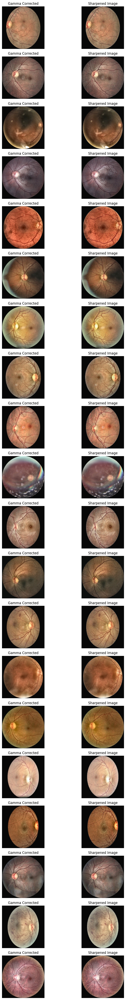

In [32]:
sample_images = all_df.sample(n=20, random_state=42)

# Create subplots
fig, axes = plt.subplots(20, 2, figsize=(10, 50))

for i, (_, row) in enumerate(sample_images.iterrows()):
    gamma_img_path = row["gamma_corrected_img_path"]
    sharp_img_path = row["processed_img_path"]
    
    # Read images
    gamma_img = cv2.imread(gamma_img_path, cv2.IMREAD_COLOR)
    gamma_img = cv2.cvtColor(gamma_img, cv2.COLOR_BGR2RGB)
    
    sharp_img = cv2.imread(sharp_img_path, cv2.IMREAD_COLOR)
    sharp_img = cv2.cvtColor(sharp_img, cv2.COLOR_BGR2RGB)
    
    # Plot gamma-corrected image
    axes[i, 0].imshow(gamma_img)
    axes[i, 0].set_title("Gamma Corrected")
    axes[i, 0].axis("off")
    
    # Plot sharpened image
    axes[i, 1].imshow(sharp_img)
    axes[i, 1].set_title("Sharpened Image")
    axes[i, 1].axis("off")

# Show the comparison
plt.tight_layout()
plt.show()

In [ ]:
all_df = pd.read_csv("processed.csv") # processed_img_path images are basically sharped images 
all_df.head()

,image_path,label,intensity,bin,cropped_img_path,resized_cropped_img_path,clahe_rgb_img_path,new_image_intensity,norm_img_path,gamma_corrected_img_path,processed_img_path
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,79.770064,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,66.015134,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.230956,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.100324,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,69.631237,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...


In [34]:
all_df.shape

(92455, 11)

In [35]:
# Compute intensity for processed_images (sharped) images
new_intensities = []
for img_path in tqdm(all_df["processed_img_path"], desc="Computing Intensity"):
    new_intensities.append(compute_intensity(img_path))

# Add to DataFrame
all_df["ap_new_intensity"] = new_intensities

Computing Intensity: 100%|██████████| 92455/92455 [02:14<00:00, 689.91it/s]


In [36]:
all_df.head()

,image_path,label,intensity,bin,cropped_img_path,resized_cropped_img_path,clahe_rgb_img_path,new_image_intensity,norm_img_path,gamma_corrected_img_path,processed_img_path,ap_new_intensity
0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,122.218802,5,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,79.770064,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,88.617854
1,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,90.635179,4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,66.015134,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,76.392390
2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,44.902353,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.230956,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,71.359856
3,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,45.971277,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,59.100324,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,72.469279
4,/Users/meetsudra/Downloads/DiabeticRetino/arch...,0,58.724107,2,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,69.631237,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,/Users/meetsudra/Downloads/DiabeticRetino/arch...,81.974997


In [38]:
all_df = all_df[["label","processed_img_path","ap_new_intensity"]]
all_df.head()

,label,processed_img_path,ap_new_intensity
0,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,88.617854
1,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,76.392390
2,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,71.359856
3,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,72.469279
4,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,81.974997


# Now Deleting images which didnt improve at all after processing them. Lets give a look at extremely underexposed and overexposed image 

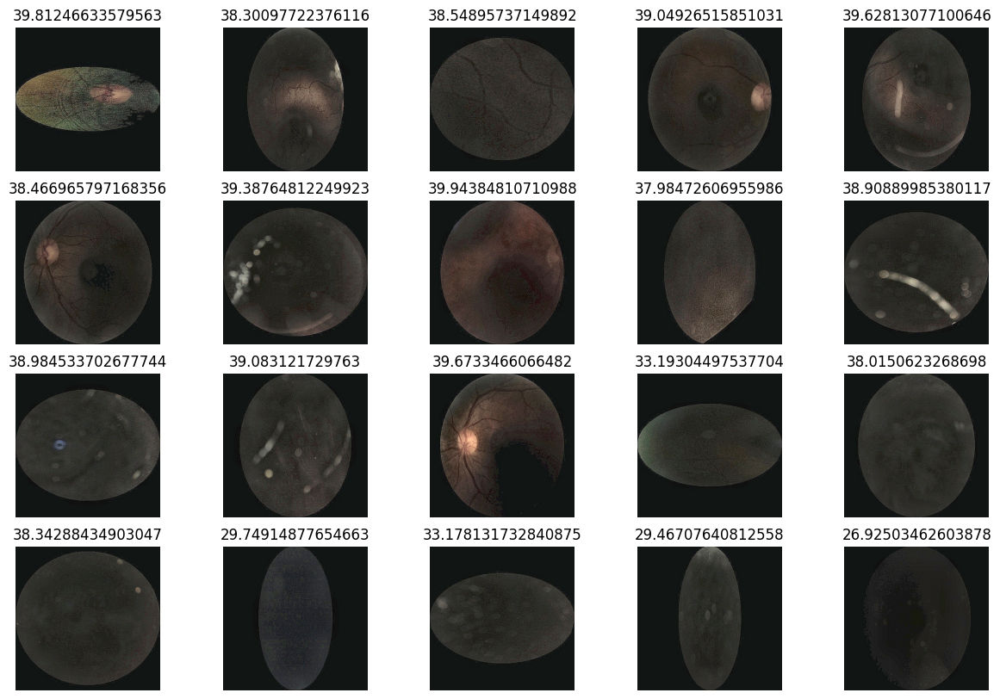

In [51]:
import matplotlib.pyplot as plt
import cv2

# Filter images with intensity < 20
low_intensity_df = all_df[all_df["ap_new_intensity"] < 40].head(20)

# Display the images
plt.figure(figsize=(15, 10))
for i, (_, row) in enumerate(low_intensity_df.iterrows()):
    img_path = row["processed_img_path"]
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

    plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
    plt.imshow(img)
    plt.title(f"{row['ap_new_intensity']}")
    plt.axis("off")

plt.show()

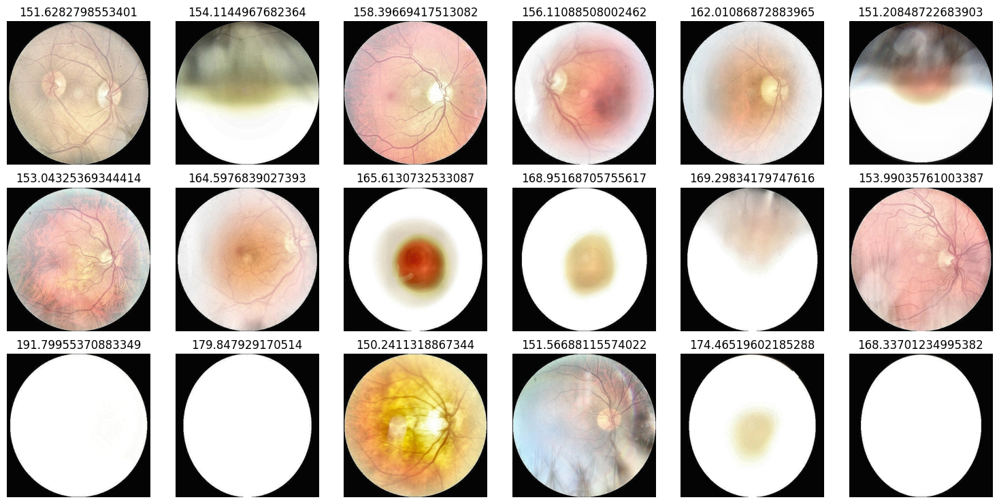

In [48]:
import math
# Filter images with intensity > 160
high_intensity_df = all_df[all_df["ap_new_intensity"] > 150]

# Number of images
num_images = len(high_intensity_df)

# Set up the number of rows and columns dynamically
num_cols = 6  # Fixed number of columns
num_rows = math.ceil(num_images / num_cols)  # Calculate required rows

# Display the images
plt.figure(figsize=(15, num_rows * 2.5))
for i, (_, row) in enumerate(high_intensity_df.iterrows()):
    img_path = row["processed_img_path"]
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

    plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(img)
    plt.title(f"{row['ap_new_intensity']}")
    plt.axis("off")

plt.tight_layout()
plt.show()


# Simply filtering images with intensity greater then 40 and less then 165

In [52]:
# Filter all_df for intensity between 40 and 165
filtered_df = all_df[(all_df["ap_new_intensity"] >= 40) & (all_df["ap_new_intensity"] <= 165)]

# Identify images to delete (outside intensity range)
images_to_delete = all_df[~all_df.index.isin(filtered_df.index)]["processed_img_path"]

# Delete those images from the processed_img folder
for img_path in images_to_delete:
    full_path = os.path.join(processed_dir, os.path.basename(img_path))
    if os.path.exists(full_path):
        os.remove(full_path)

# Save the filtered DataFrame to a CSV
filtered_csv_path = "readyforsplitting.csv"
filtered_df.to_csv(filtered_csv_path, index=False)

# Confirm
print(" Unwanted images deleted.")
print(f" Filtered DataFrame saved to: {filtered_csv_path}")


 Unwanted images deleted.
 Filtered DataFrame saved to: readyforsplitting.csv


In [64]:
df = pd.read_csv("readyforsplitting.csv")
df.rename(columns={"processed_img_path":"image_path"},inplace=True)
df.head()

,label,image_path,ap_new_intensity
0,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,88.617854
1,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,76.392390
2,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,71.359856
3,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,72.469279
4,0,/Users/meetsudra/Downloads/DiabeticRetino/arch...,81.974997


In [65]:
# Directories for train, val, and test
base_dir = "/Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2"
train_dir = os.path.join(base_dir, "ptrain_img")
val_dir = os.path.join(base_dir, "pval_img")
test_dir = os.path.join(base_dir, "ptest_img")

# Ensure directories exist
for d in [train_dir, val_dir, test_dir]:
    os.makedirs(d, exist_ok=True)

# Load processed dataset
processed_csv_path = os.path.join(base_dir, "readyforsplitting.csv")
df = pd.read_csv(processed_csv_path)
df.rename(columns={"processed_img_path":"image_path"},inplace=True)

# Split dataset into Train (80%), Validation (10%), Test (10%)
train_df, temp_df = train_test_split(df, test_size=0.2, stratify=df["label"], random_state=42)
val_df, test_df = train_test_split(temp_df, test_size=0.5, stratify=temp_df["label"], random_state=42)

# Function to move images to the corresponding directory
def move_images(df_subset, target_dir):
    new_paths = []
    for img_path in df_subset["image_path"]:
        new_path = os.path.join(target_dir, os.path.basename(img_path))
        if os.path.exists(img_path):
            shutil.move(img_path, new_path)
        new_paths.append(new_path)
    return new_paths

# Move images to respective directories and update paths
train_df["image_path"] = move_images(train_df, train_dir)
val_df["image_path"] = move_images(val_df, val_dir)
test_df["image_path"] = move_images(test_df, test_dir)

# Save updated CSVs
train_csv = os.path.join(base_dir, "ptrain.csv")
val_csv = os.path.join(base_dir, "pval.csv")
test_csv = os.path.join(base_dir, "ptest.csv")

train_df[["image_path", "label"]].to_csv(train_csv, index=False)
val_df[["image_path", "label"]].to_csv(val_csv, index=False)
test_df[["image_path", "label"]].to_csv(test_csv, index=False)

# Print confirmation
print(f"Train images saved in: {train_dir}")
print(f"Validation images saved in: {val_dir}")
print(f"Test images saved in: {test_dir}")
print(f"CSV files saved: {train_csv}, {val_csv}, {test_csv}")


Train images saved in: /Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/ptrain_img
Validation images saved in: /Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/pval_img
Test images saved in: /Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/ptest_img
CSV files saved: /Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/ptrain.csv, /Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/pval.csv, /Users/meetsudra/Downloads/DiabeticRetino/archive/dr_unified_v2/dr_unified_v2/ptest.csv


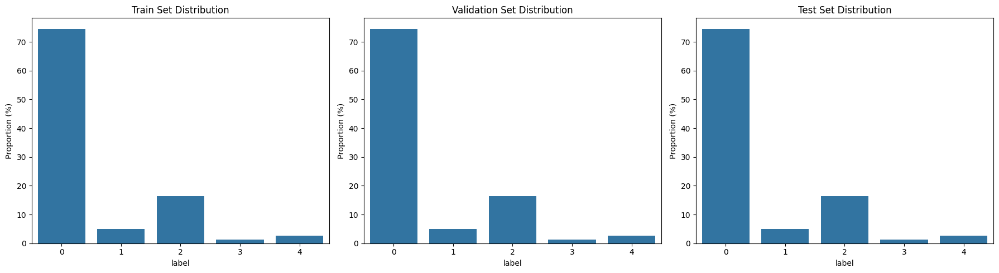

In [66]:
train_csv = os.path.join(base_dir, "ptrain.csv")
val_csv = os.path.join(base_dir, "pval.csv")
test_csv = os.path.join(base_dir, "ptest.csv")

train_df = pd.read_csv(train_csv)
val_df = pd.read_csv(val_csv)
test_df = pd.read_csv(test_csv)

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Train Set Distribution
sns.barplot(x=train_df["label"].value_counts().index, 
            y=train_df["label"].value_counts(normalize=True) * 100, ax=axes[0])
axes[0].set_title("Train Set Distribution")
axes[0].set_ylabel("Proportion (%)")

# Validation Set Distribution
sns.barplot(x=val_df["label"].value_counts().index, 
            y=val_df["label"].value_counts(normalize=True) * 100, ax=axes[1])
axes[1].set_title("Validation Set Distribution")
axes[1].set_ylabel("Proportion (%)")

# Test Set Distribution
sns.barplot(x=test_df["label"].value_counts().index, 
            y=test_df["label"].value_counts(normalize=True) * 100, ax=axes[2])
axes[2].set_title("Test Set Distribution")
axes[2].set_ylabel("Proportion (%)")

# Show plots
plt.tight_layout()
plt.show()


In [67]:
train_df.shape

(73932, 2)

In [68]:
test_df.shape

(9242, 2)

In [69]:
val_df.shape

(9241, 2)